In [1]:
## Standard imports
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import os
import json
import torch
import astroddpm
import tqdm.notebook as tqdm

## Relative imports
from astroddpm.runners import Diffuser, config_from_id, get_samples
from astroddpm.analysis.validationMetrics import powerSpectrum, minkowskiFunctional, basics
from astroddpm.analysis import overfitting_check
from astroddpm.utils.plot import check_nearest_epoch, plot_losses, check_training_samples, plot_comparaison
from astroddpm.diffusion.dm import DiscreteSBM
from astroddpm.diffusion.stochastic.sde import DiscreteVPSDE
from astroddpm.diffusion.models.network import ResUNet
import astroddpm.utils.colormap_custom 

In [2]:
ALL_MODELS = os.path.join(os.path.dirname(astroddpm.__file__), 'config', 'MODELS.json')

with open(ALL_MODELS, 'r') as f:
    ALL_MODELS_DICT = json.load(f)
print(ALL_MODELS_DICT.keys())

dict_keys(['DiscreteSBM_ND_SigmaVPSDE_MHD_BPROJ_N_4000_bottleneck_32', 'DiscreteSBM_ND_SigmaVPSDE_MHD_BPROJ_N_1000_bottleneck_16', 'DiscreteSBM_ND_SigmaVPSDE_MHD_BPROJ_N_4000_bottleneck_16', 'DiscreteSBM_ND_VPSDE_MHD_BPROJ_N_1000_bottleneck_32', 'DiscreteSBM_ND_VPSDE_MHD_BPROJ_N_1000_bottleneck_16', 'DiscreteSBM_ND_SigmaVPSDE_MHD_BPROJ_N_8000_bottleneck_16', 'DiscreteSBM_ND_VPSDE_MHD_BPROJ_N_4000_bottleneck_32', 'DiscreteSBM_ND_SigmaVPSDE_MHD_BPROJ_N_8000_bottleneck_32', 'DiscreteSBM_ND_VPSDE_MHD_BPROJ_N_4000_bottleneck_16', 'DiscreteSBM_ND_VPSDE_MHD_BPROJ_N_8000_bottleneck_32', 'DiscreteSBM_ND_VPSDE_MHD_BPROJ_N_8000_bottleneck_16', 'DiscreteSBM_ND_SigmaVPSDE_MHD_BPROJ_N_1000_bottleneck_32', 'DiscreteSBM_ND_SigmaVPSDE_MHD_BPROJ_N_4000_bottleneck_32_betamin_0.01_step', 'DiscreteSBM_ND_SigmaVPSDE_MHD_BPROJ_N_4000_bottleneck_32_betamin_0.05_invsqrt', 'DiscreteSBM_ND_SigmaVPSDE_MHD_BPROJ_N_1000_bottleneck_16_betamin_0.05_step', 'DiscreteSBM_ND_SigmaVPSDE_MHD_BPROJ_N_4000_bottleneck_32_beta

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
amin = - 3
amax = 3

MODEL_ID = 'DiscreteSBM_MultiSigmaVPSDE_MHD_BPROJ_N_1000_bottleneck_32_firstc_20_invsqrt'

In [4]:
placeholder_dm = DiscreteSBM(DiscreteVPSDE(1000), ResUNet())
diffuser = Diffuser(placeholder_dm)
diffuser.load(config=config_from_id(MODEL_ID), also_ckpt=True, for_training=True)

No model id found
Loading the diffuser from a config dict.
Loading the optimizer and scheduler states from the checkpoint, as well as previous training info. You should change the model id if you want to finetune the model.


## Different images of the problem

In [5]:
t = 100
noise_level = diffuser.diffmodel.sde.noise_level(t).reshape(-1)
noise_level

tensor([0.3436], device='cuda:0')

In [6]:
batch = next(iter(diffuser.train_dataloader))
batch = batch.to(device).unsqueeze(1)
batch.shape

torch.Size([64, 1, 256, 256])

In [7]:
ps, theta = diffuser.diffmodel.ps.sample_ps(1)
sq_ps = torch.sqrt(ps).to(device)
noisy, mean, noise = diffuser.diffmodel.sde.sampling(batch, 150, sq_ps)

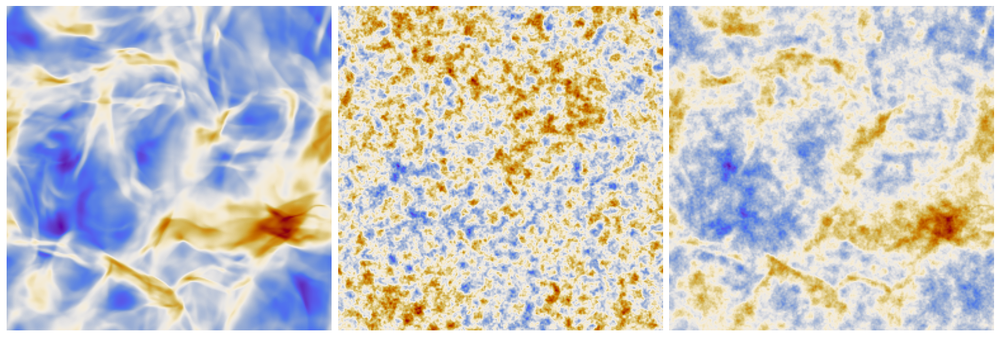

In [8]:
fig, ax = plt.subplots(1, 3, figsize=(15, 5), layout = 'constrained')
ax[0].imshow(batch[0, 0].cpu().numpy(), cmap='cmb')
ax[0].axis('off')
ax[1].imshow(noise[0, 0].cpu().numpy(), cmap='cmb')
ax[1].axis('off')
ax[2].imshow(noisy[0, 0].cpu().numpy(), cmap='cmb')
ax[2].axis('off')
fig.savefig('problem.pdf')

## Results visualization

Nearest epoch found is 11800
Summing over the first dimensions


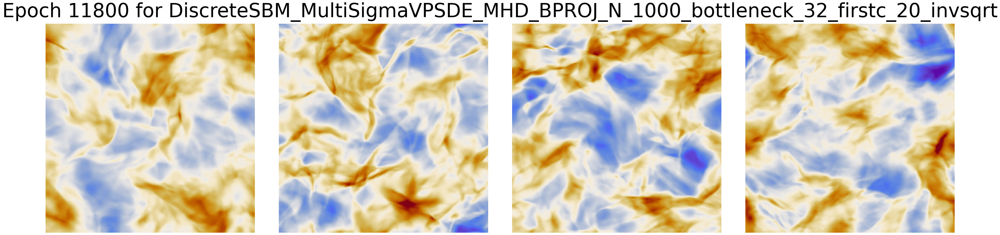

In [9]:
check_nearest_epoch(diffuser, 20000, max_to_plot=4, amin = -3.5, amax = 3.5)

Summing over the first dimensions


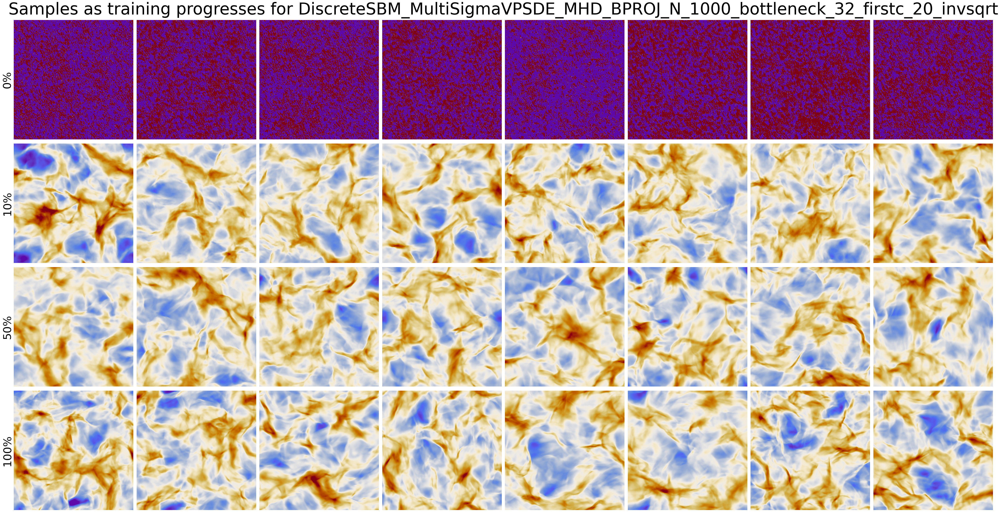

In [10]:
check_training_samples(diffuser, max_to_plot=8, elementary_figsize = (6,6), amin = -3.5, amax = 3.5)

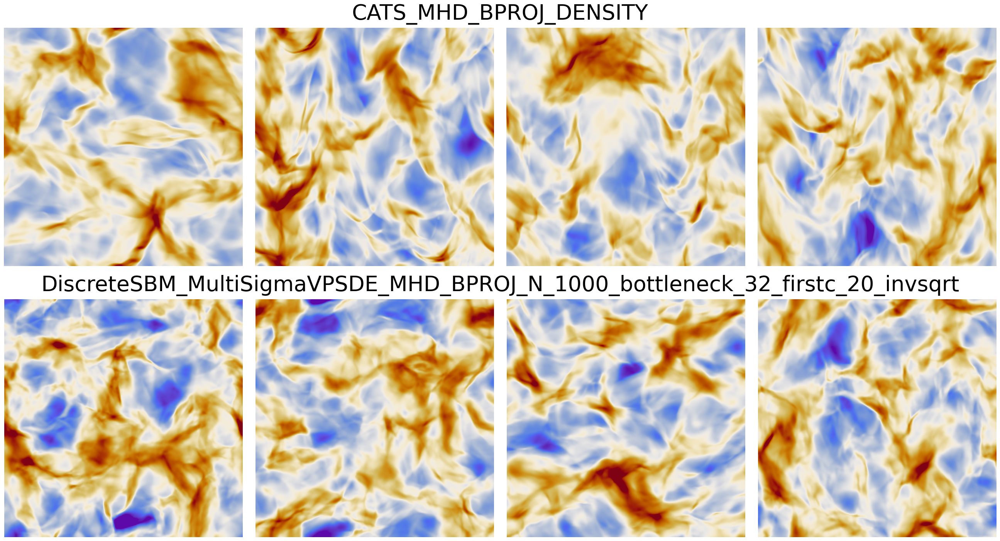

In [11]:
plot_comparaison(diffuser, 4, elementary_figsize=(6,6), amin = -3, amax = 3)

#### If you wish to create other pictures

In [12]:
## Generated samples

samples = get_samples(diffuser)

## Batch contains element of the dataset

## Summary statistics

### Basics

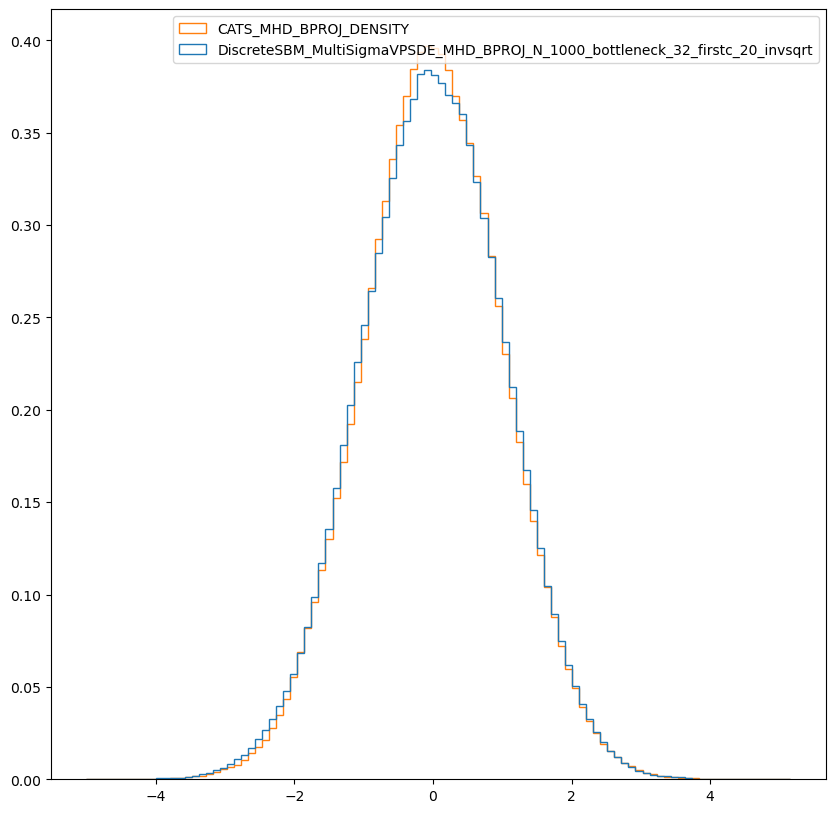

In [13]:
basics.plot_hist_samples_dataset(diffuser, max_num_samples=100)

In [14]:
basics.wasserstein(diffuser, max_num_samples=100)

0.020159133581481123

### Power Spectrum

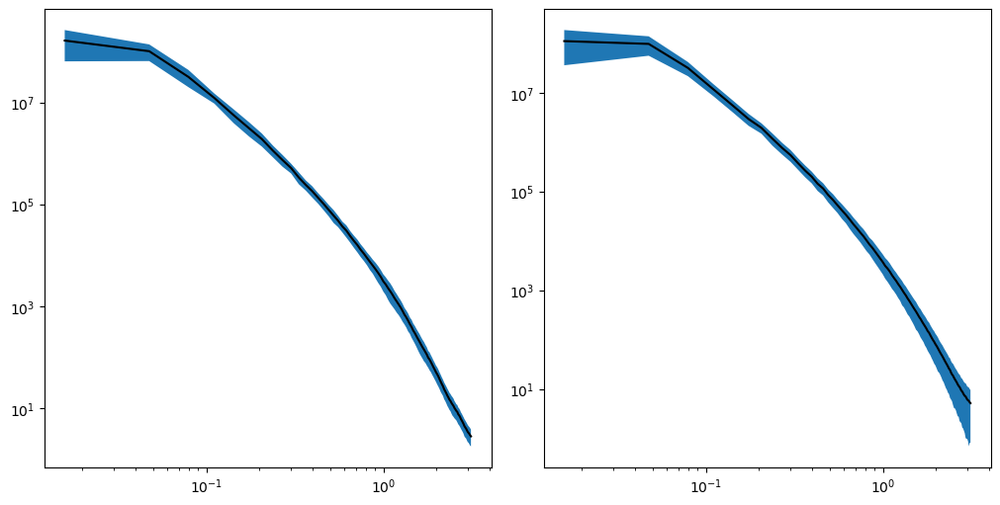

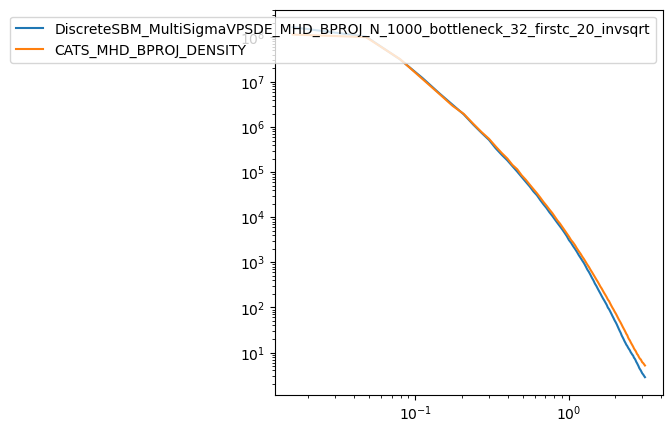

In [15]:
mean_list, std_list, bins_centers, labels = powerSpectrum.plot_ps_samples_dataset(diffuser, max_num_samples=128, use_gpu=False)

In [16]:
### Other method
### mean_list, std_list, bins_centers, labels = powerSpectrum.plot_sets_power_spectrum_iso2d([batch, samples])

In [17]:
mean_list = [mean.cpu().numpy() for mean in mean_list]
std_list = [std.cpu().numpy() for std in std_list]

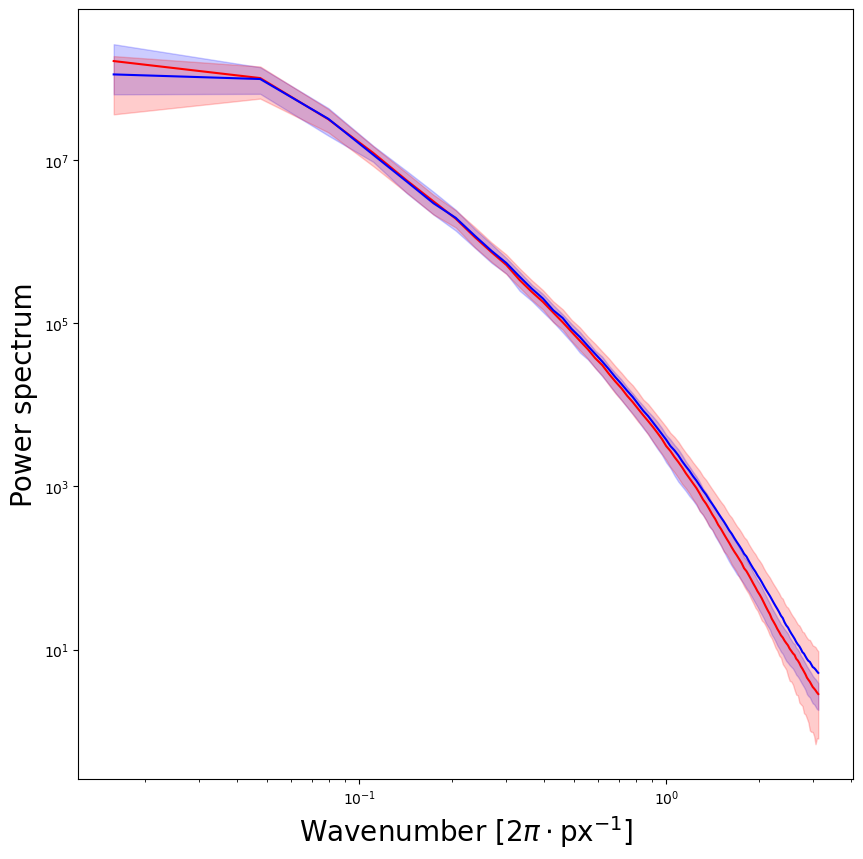

In [18]:
## Plot on the same figure all the elements from mean_list and std_list with different colors
fig, ax = plt.subplots(figsize=(10, 10))
ax.plot(bins_centers, mean_list[0][:-1], color='r')
ax.fill_between(bins_centers, mean_list[0][:-1] - std_list[0][:-1], mean_list[0][:-1] + std_list[0][:-1], alpha=0.2, color='b')

ax.plot(bins_centers, mean_list[1][:-1], color = 'b')
ax.fill_between(bins_centers, mean_list[1][:-1] - std_list[1][:-1], mean_list[1][:-1] + std_list[1][:-1], alpha=0.2,color = 'r')

ax.set_xlabel('Wavenumber [$2\pi\cdot \mathrm{px}^{-1}$]', fontsize=20)
ax.set_ylabel('Power spectrum', fontsize=20)

ax.set_xscale('log')
ax.set_yscale('log')
plt.savefig('power_spectrum_highnoise.pdf')
plt.show()

### Minkowski functionnals

In [19]:
samples = basics.get_samples(diffuser)
l_samples = np.split(samples, len(samples), axis=0)
l_samples = [l_samples[i][0][0] for i in range(len(l_samples))]

dataset = diffuser.train_dataloader.dataset

num_dataset_samples = 128

l_dataset = [dataset[i].numpy().copy(order = 'C') for i in range(num_dataset_samples)]

try:
    labels_diffuser = diffuser.config["model_id"]
    raise Exception("Not implemented")
except:
    labels_diffuser = "Samples"

try:
    labels_dataset = diffuser.config["dataloaders"]["dataset"]["name"]
    raise Exception("Not implemented")
except:
    labels_dataset = "Original"

range_min = -8

range_max = 8


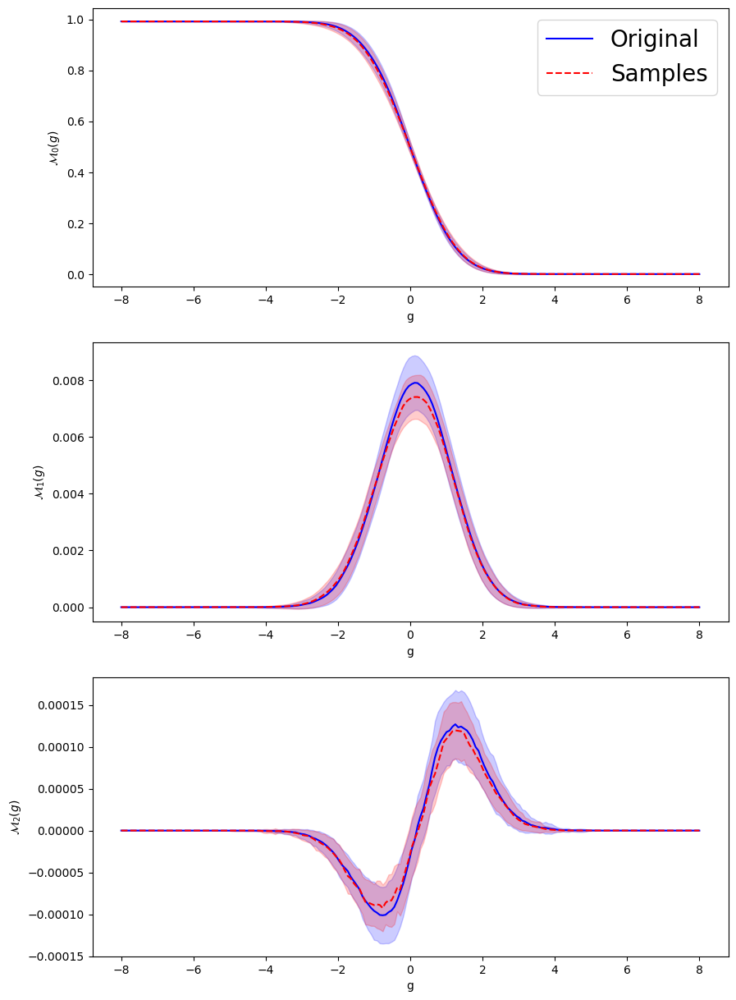

In [20]:
smm, sms=minkowskiFunctional.plot_mink_functionals([l_dataset,l_samples],gs_vals = np.linspace(range_min, range_max, 200),
          names = [labels_dataset, labels_diffuser], cols = ['b', 'r'], 
          savefig_dict={})

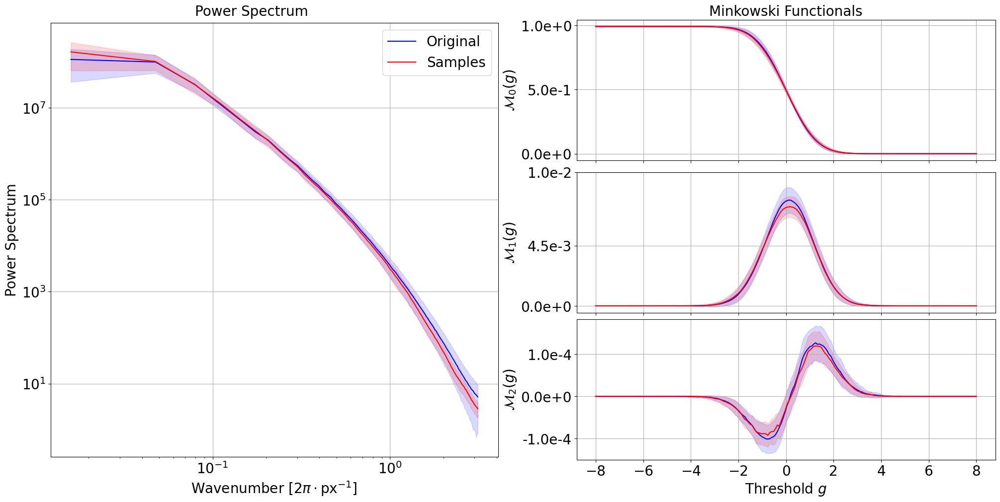

In [21]:
## Plot side by side, on the left the power spectra with mean and std and on the right the minkowski functionals with mean and std
fontsize = 20
alpha = 0.15
grid = True
savefig = False


fig, ax = plt.subplots(figsize=(20, 10), layout = 'constrained')

subfig = fig.subfigures(1, 2, wspace=0.0)

# Plot power spectra
ax_left = subfig[0].subplots(1, 1)
mean_list = mean_list[::-1]
std_list = std_list[::-1]

ax_left.plot(bins_centers, mean_list[0][:-1], color='b', label='Original')
ax_left.fill_between(bins_centers, mean_list[0][:-1] - std_list[0][:-1], mean_list[0][:-1] + std_list[0][:-1], alpha=alpha, color='b')

ax_left.plot(bins_centers, mean_list[1][:-1], color = 'r', label='Samples')
ax_left.fill_between(bins_centers, mean_list[1][:-1] - std_list[1][:-1], mean_list[1][:-1] + std_list[1][:-1], alpha=alpha, color='r')

ax_left.set_xlabel('Wavenumber [$2\pi\cdot\mathrm{px}^{-1}$]', fontsize=20)
ax_left.set_ylabel('Power Spectrum', fontsize=20)

ax_left.legend(prop={'size': 20})
ax_left.set_xscale('log')
ax_left.set_yscale('log')
ax_left.grid(grid)
plt.yticks(fontsize=20)
plt.xticks(fontsize=20)
subfig[0].suptitle('Power Spectrum', fontsize=20)

# Plot minkowski functionals
## Create three subplots sharing the x axis

def format_ticks(value, tick_number):
    return "{:.1e}".format(value).replace("e+0", "e+").replace("e-0", "e-")

ax_right = subfig[1].subplots(3, 1, sharex=True)

ax_right[0].plot(np.linspace(range_min, range_max, 200), smm[0][:, 0], color='b')
ax_right[0].fill_between(np.linspace(range_min, range_max, 200), smm[0][:, 0] - sms[0][:, 0], smm[0][:, 0] + sms[0][:, 0], alpha=alpha, color='b')

ax_right[0].plot(np.linspace(range_min, range_max, 200), smm[1][:, 0], color='r')
ax_right[0].fill_between(np.linspace(range_min, range_max, 200), smm[1][:, 0] - sms[1][:, 0], smm[1][:, 0] + sms[1][:, 0], alpha=alpha, color='r')

ax_right[0].set_ylabel('$\mathcal{M}_{0}(g)$', fontsize=20)
ax_right[0].set_title('Minkowski Functionals', fontsize=20)
ax_right[0].set_yticks([0 ,0.5, 1], labels =[0 ,0.5, 1] ,fontsize=20)
ax_right[0].yaxis.set_major_formatter(ticker.FuncFormatter(format_ticks))

ax_right[1].plot(np.linspace(range_min, range_max, 200), smm[0][:, 1], color='b')
ax_right[1].fill_between(np.linspace(range_min, range_max, 200), smm[0][:, 1] - sms[0][:, 1], smm[0][:, 1] + sms[0][:, 1], alpha=alpha, color='b')

ax_right[1].plot(np.linspace(range_min, range_max, 200), smm[1][:, 1], color='r')
ax_right[1].fill_between(np.linspace(range_min, range_max, 200), smm[1][:, 1] - sms[1][:, 1], smm[1][:, 1] + sms[1][:, 1], alpha=alpha, color='r')

ax_right[1].set_ylabel('$\mathcal{M}_{1}(g)$', fontsize=20)
ax_right[1].set_yticks([0 ,4.5e-3, 1e-2], labels =[0 ,4.5e-3, 1e-2] ,fontsize=20)
ax_right[1].yaxis.set_major_formatter(ticker.FuncFormatter(format_ticks))

ax_right[2].plot(np.linspace(range_min, range_max, 200), smm[0][:, 2], color='b')
ax_right[2].fill_between(np.linspace(range_min, range_max, 200), smm[0][:, 2] - sms[0][:, 2], smm[0][:, 2] + sms[0][:, 2], alpha=alpha, color='b')

ax_right[2].plot(np.linspace(range_min, range_max, 200), smm[1][:, 2], color='r')
ax_right[2].fill_between(np.linspace(range_min, range_max, 200), smm[1][:, 2] - sms[1][:, 2], smm[1][:, 2] + sms[1][:, 2], alpha=alpha, color='r')

ax_right[2].set_ylabel('$\mathcal{M}_{2}(g)$', fontsize=20)
ax_right[2].set_xlabel('Threshold $g$', fontsize=20)
ax_right[2].tick_params(axis='y', which='major', labelsize=20)
ax_right[2].yaxis.set_major_formatter(ticker.FuncFormatter(format_ticks))
for ax in ax_right:
    ax.grid(grid)

plt.xticks(fontsize=20)

if savefig:
    if grid:
        plt.savefig(os.path.join(os.path.dirname(os.path.dirname(astroddpm.__file__)),'images','summary_stat_comp_gauss_noise_grid.pdf'))
    else:
        plt.savefig(os.path.join(os.path.dirname(os.path.dirname(astroddpm.__file__)),'images','summary_stat_comp_gauss_noise.pdf'))


## Overfitting check

In [22]:
BORDER_PERIODIC = True ## Computations will change depending on the boundary conditions, for non border periodic, L2 distance is enough, for border periodic, we need to use the distance in Fourrier space to account for the symetry of the problem ONLY TRUE for now in the package.

#### Diversity of samples check

- Check the samples against one another (and compute some metrics on it as well as plot the closest samples)
- Check the samples against data points

For border periodic fields, all these computations will be up to a translation of a vector $\vec{r}$

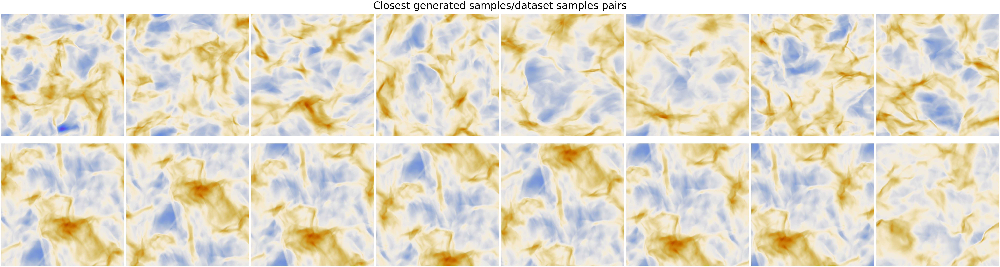

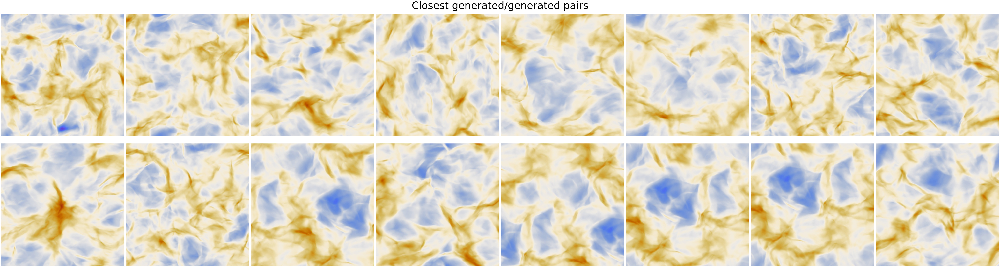

In [23]:
overfitting_check.plot_closest_pairs_samples_dataset(diffuser)

Sanity check, images should be the same in the top and bottom rows.

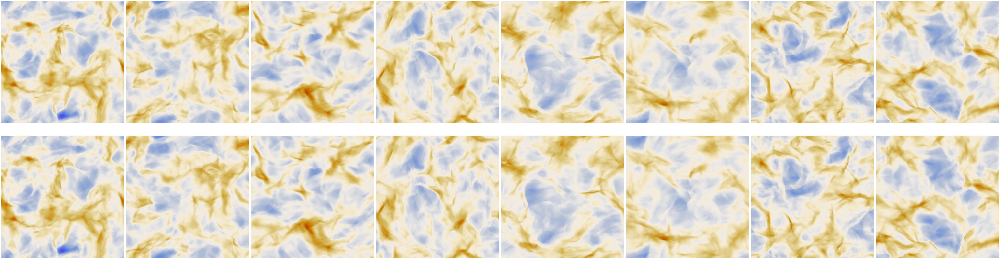

In [24]:
samples = get_samples(diffuser)
samples = torch.from_numpy(samples)
samples.unsqueeze(1)
overfitting_check.plot_closest_pairs_sanity_check(samples) ##Input a batch of shape B C H W

## ODE SAMPLING

In [42]:
num_ode_samples = 64

In [43]:
## A theta approximately equal to the mean of the prior on theta
theta = diffuser.diffmodel.ps.sample_theta(1000).mean(dim = 0, keepdim = True).repeat(num_ode_samples, 1).to(device)
theta[0]

tensor([7.0555e+01, 3.2251e-02], device='cuda:0')

In [44]:
ode_samples = diffuser.diffmodel.ode_sampling(num_ode_samples, thetas = theta)

  0%|          | 3/1000 [00:00<00:57, 17.22it/s]

100%|██████████| 1000/1000 [01:20<00:00, 12.41it/s]


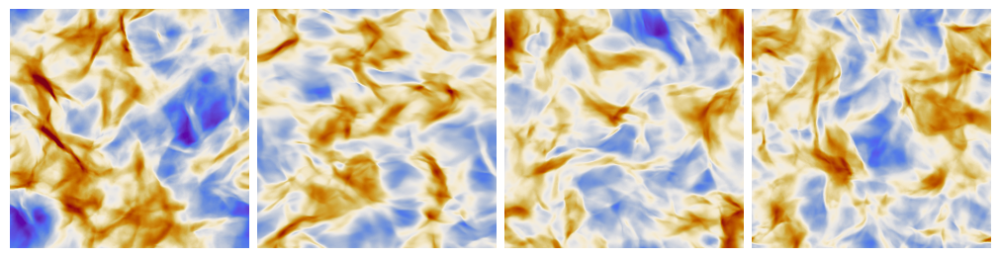

In [45]:
## Plot the samples
fig, axs = plt.subplots(1, 4, figsize=(10,10), layout = 'constrained')
for i in range(4):
        axs[i].imshow(ode_samples[i][0].cpu().numpy(), cmap = 'cmb', vmin = amin, vmax = amax)
        axs[i].axis('off')


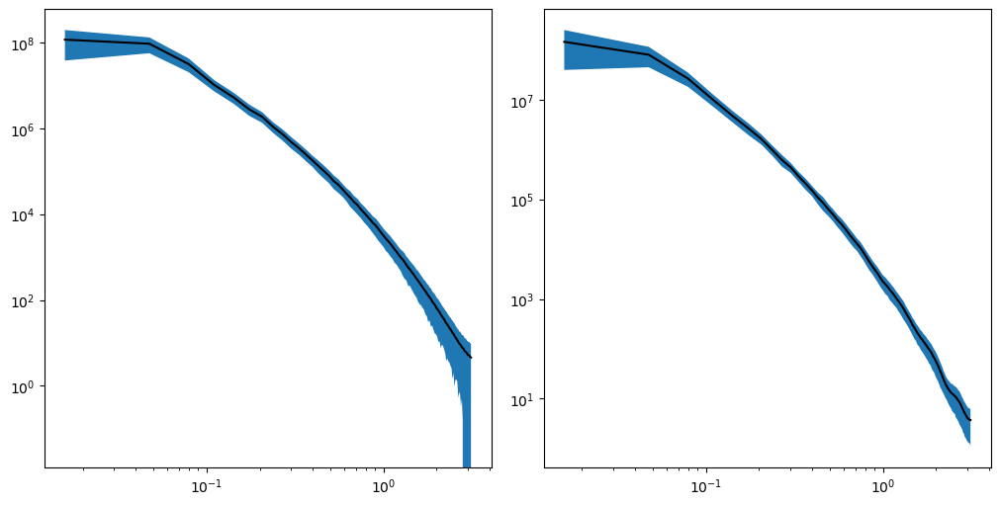

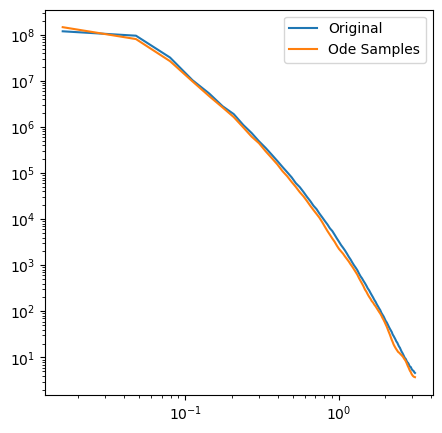

In [46]:
ode_mean_list, ode_std_list, _, ode_labels = powerSpectrum.plot_sets_power_spectrum_iso2d([batch, ode_samples], labels = ['Original', 'Ode Samples'], use_gpu=True)

#### Latent codes
To compare latent codes, you need to switch diffusion model. Be carefull about the theta you chose...upcoming notebook with option for two diffuser to compare latent codes

In [30]:
def forward_ode_sampling(diffuser, sample):
    diffuser.diffmodel.eval()
    gen = sample.to(device).clone()
    with torch.no_grad():
        progress_bar = tqdm.tqdm(total=diffuser.diffmodel.sde.N)
        for i in range(diffuser.diffmodel.sde.N):
            timesteps = torch.tensor([i]).repeat(len(sample)).to(device)
            modified_score = diffuser.diffmodel.network(gen, timesteps)
            gen -= diffuser.diffmodel.sde.ode_drift(gen, timesteps, modified_score)
            progress_bar.update(1)
    return gen

In [31]:
forward_gen = forward_ode_sampling(diffuser, batch)

  0%|          | 0/1000 [00:00<?, ?it/s]

(-0.5, 255.5, 255.5, -0.5)

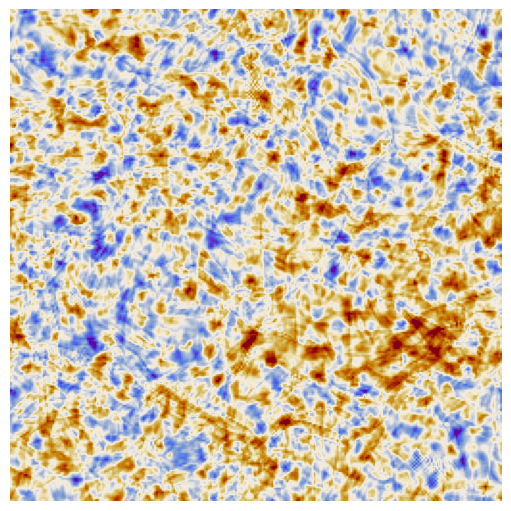

In [32]:
fig, ax = plt.subplots(1, 1, figsize=(5,5), layout = 'constrained')
ax.imshow(forward_gen[0][0].cpu().numpy(), vmin = -3, vmax = 3, cmap = 'cmb')
ax.axis('off')

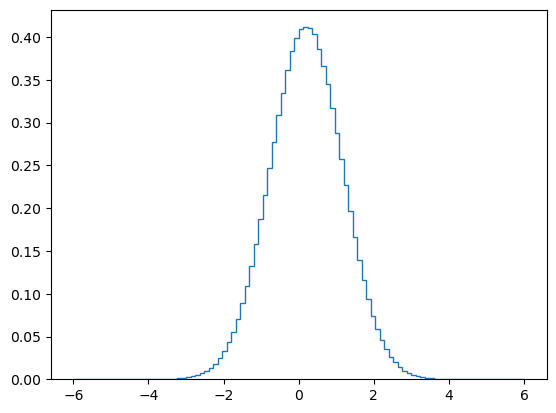

In [33]:
plt.hist(forward_gen.cpu().numpy().flatten(), bins=100, range=(-6,6), density=True, histtype='step', label='ODE')
plt.show()

In [34]:
forward_gen[3].mean(), forward_gen[3].std()

(tensor(0.1850, device='cuda:0'), tensor(0.9494, device='cuda:0'))